## Import Libraries

In [8]:
try:
  import os
  # To handle image file
  from PIL import Image
  # For displaying images
  import matplotlib.pyplot as plt
  import copy
  # For using deep learning methods
  import torch
  import torch.nn.functional as F
  import torch.nn as nn
  import torch.optim as optim
  # For doing transformation on images and using pretrained models
  import torchvision.transforms as transforms
  from torchvision.models import vgg19, VGG19_Weights

except:
  !pip install torch
  !pip install matplotlib
  !pip install Pillow
  !pip install torchvision

  import os
  from PIL import Image
  import matplotlib.pyplot as plt
  import copy
  import torch
  import torch.nn.functional as F
  import torch.nn as nn
  import torch.optim as optim

  import torchvision.transforms as transforms
  from torchvision.models import vgg19, VGG19_Weights

In [9]:
#  Switch to GPU if available
device = torch.device("cpu")
if torch.cuda.is_available():
  device = torch.device("cuda")
torch.set_default_device(device)

## Image Preprocessing

In [10]:
# If gpu available, then deal with a larger image file
imgsize = 128
if torch.cuda.is_available():
  imgsize=512

In [11]:
preprocessor = transforms.Compose([
    # Resize the input image and convert to tensor
    transforms.Resize((imgsize, imgsize)),
    transforms.ToTensor()])

def preprocess(image_name):
    image = Image.open(image_name)

    image = preprocessor(image)
    # Model receives input in batches, so add a extra dimension
    image=image.unsqueeze(0)
    return image.to(device, torch.float)


In [12]:
BackToImg = transforms.ToPILImage()  # reconvert into PIL image

plt.ion()

def imshow(tensor, title=None,save_fig=False,save_name="output.jpg"):
    '''
    Function to show the image given input as a tensor
    '''
    image = tensor.cpu().clone()  # we clone the tensor to not do changes on it
    image = image.squeeze(0)      # remove the fake batch dimension
    image = BackToImg(image)
    plt.imshow(image)
    if title is not None:
        plt.title(title)
    if save_fig:
      plt.savefig(save_name)

## Content Loss

Suppose you have content image C, and a style image S, and a image M which is a mix of the content and style image. This image M will be the in which content of the content image S will be present with style present in style image S.

In order to have same content in M and C, we need to make sure that difference of corresponding pixel values in both images is nearly same. Thus, we will try to bring down the difference between corresponding pixel values of M and C. So, in this case it is suitable to use the mean squared error loss function. So $$\mathcal{L}_{content}(C,M)=Σ_iΣ_j(C_{i,j}-M_{i,j})^2$$
where $C_{i,j}$ and $M_{i,j}$ are pixel values of the images $C$ and $M$ respectively, at position $i,j$ in the image.

In [13]:
class ContentLoss(nn.Module):
    def __init__(self, target,):
        super(ContentLoss, self).__init__()
        self.target = target.detach()

    def forward(self, input):
      '''
      Given an input image on which style transfer is performed, and the original
      content image.
      Calculate the difference between them using Mean Squared Error.
      '''
      self.loss = F.mse_loss(input, self.target)
      return input

## Style Loss

For style loss,we will utilize the gram matrix. Let $\mathcal{G^s}$ and $\mathcal{G^m}$ be the Gram matrix of style image $S$ and image $M$, then $$\mathcal{L}_{style}(S,M)=Σ_iΣ_j(G^s_{i,j}-G^m_{i,j})^2$$

In [14]:
def gram_matrix(input):
    a, b, c, d = input.size()  # a=batch size(=1)
    # b=number of feature maps
    # (c,d)=dimensions of a f. map (N=c*d)

    features = input.view(a * b, c * d)  # resize F_XL into \hat F_XL

    G = torch.mm(features, features.t())  # compute the gram product

    # we 'normalize' the values of the gram matrix
    # by dividing by the number of element in each feature maps.
    return G.div(a * b * c * d)

In [15]:
class StyleLoss(nn.Module):

    def __init__(self, target_feature):
        super(StyleLoss, self).__init__()
        self.target = gram_matrix(target_feature).detach()

    def forward(self, input):
        G = gram_matrix(input)
        self.loss = F.mse_loss(G, self.target)
        return input

Total loss is $$\mathcal{L}_{total}(C,S,M)=\mathcal{L}_{content}(C,M)+\mathcal{L}_{style}(S,M)$$

## Building Model Layers
We use the pre-trained VGGNet Model with its head removed. Head is removed because we don't need to classify images and we only need the part of the input where we get a good representation of the image. The model is inspired from the research paper https://arxiv.org/pdf/1508.06576.pdf

In [16]:
cnn = vgg19(weights=VGG19_Weights.DEFAULT).features.eval()

### Normalization Layer
Furthermore, VGG networks are trained using images where each color channel is standardized by mean values of [0.485, 0.456, 0.406] and standard deviation values of [0.229, 0.224, 0.225]. We'll employ these mean and standard deviation values to normalize the image before feeding it into the network.

In [17]:
cnn_normalization_mean = torch.tensor([0.485, 0.456, 0.406])
cnn_normalization_std = torch.tensor([0.229, 0.224, 0.225])

class Normalization(nn.Module):
    def __init__(self, channel_mean, channel_std):
        super(Normalization, self).__init__()
        ## Extend the mean and std dev vector, so that each channel is standardized.
        self.channel_mean = torch.tensor(channel_mean).view(-1, 1, 1)
        self.channel_std = torch.tensor(channel_std).view(-1, 1, 1)

    def forward(self, image):
        return (image - self.channel_mean) / self.channel_std

### CNN layers

In [18]:
content_layers_default = ['conv_4']
style_layers_default = ['conv_1', 'conv_2', 'conv_3', 'conv_4', 'conv_5']

def create_model_and_calculate_loss(cnn, normalization_mean, normalization_std,
                               style_img, content_img,
                               content_layers=content_layers_default,
                               style_layers=style_layers_default):
    # normalization module
    normalization = Normalization(normalization_mean, normalization_std)
    # just in order to have an iterable access to or list of content/style
    # losses
    content_losses = []
    style_losses = []

    ## start our sequential model normalization layer.
    model = nn.Sequential(normalization)
    ## Add convolution layers, activation functions and batch norm layer.
    i = 0  # i is incrementend every time we see a conv
    for layer in cnn.children():
        if isinstance(layer, nn.Conv2d):
            i += 1
            name = 'conv_{}'.format(i)
        elif isinstance(layer, nn.ReLU):
            name = 'relu_{}'.format(i)
            layer = nn.ReLU(inplace=False)
        elif isinstance(layer, nn.MaxPool2d):
            name = 'pool_{}'.format(i)
        elif isinstance(layer, nn.BatchNorm2d):
            name = 'bn_{}'.format(i)
        else:
            raise RuntimeError('Unrecognized layer: {}'.format(layer.__class__.__name__))

        model.add_module(name, layer)

        ## Content losss calculation
        if name in content_layers:
            target = model(content_img).detach()
            content_loss = ContentLoss(target)
            model.add_module("content_loss_{}".format(i), content_loss)
            content_losses.append(content_loss)
        ## Style loss calculation
        if name in style_layers:
            target_feature = model(style_img).detach()
            style_loss = StyleLoss(target_feature)
            model.add_module("style_loss_{}".format(i), style_loss)
            style_losses.append(style_loss)

    # now we trim off the layers after the last content and style losses
    for i in range(len(model) - 1, -1, -1):
        if isinstance(model[i], ContentLoss) or isinstance(model[i], StyleLoss):
            break

    model = model[:(i + 1)]

    return model, style_losses, content_losses

Create a copy of the input image, this image will be passed as an input to the style transfer model.

In [19]:
def create_input_image(content_image):
  return content_image.clone()

### Optimizer

Create an optimizer for finding optimal weights(pixels) for the image M

In [20]:
def input_image_optimizer(input_img):
    optimizer = optim.LBFGS([input_img])
    return optimizer

## Style Transfer Function

In [21]:
def style_transfer(cnn, normalization_mean, normalization_std,
                       content_img, style_img, input_img, max_iterations=300,
                   content_loss_weight=1,style_loss_weight=1000000,show_loss_details=True):
    """Run the style transfer."""
    print('Building the style transfer model..')
    model, style_losses, content_losses = create_model_and_calculate_loss(cnn,
        normalization_mean, normalization_std, style_img, content_img)

    # Only input image needs to be optimized.
    input_img.requires_grad_(True)
    # Put the model in evaluation mode, so that batch normalization layers behave correctly.
    model.eval()
    # We don't need to update the model weights
    model.requires_grad_(False)
    # Get the optimizer
    optimizer = input_image_optimizer(input_img)

    print('Performing Style Transferring on the image')
    iteration = [0]
    while iteration[0] <= max_iterations:

        def closure():
            # correct the values of updated input image
            with torch.no_grad():
                input_img.clamp_(0, 1)
            # Perform optimization
            optimizer.zero_grad()
            model(input_img)
            style_loss = 0
            content_loss = 0
            ## Calculate Style and content loss
            for sl in style_losses:
                style_loss += sl.loss
            for cl in content_losses:
                content_loss += cl.loss

            style_loss *= style_loss_weight
            content_loss *= content_loss_weight

            loss = style_loss + content_loss
            loss.backward()
            iteration[0] += 1

            if show_loss_details:
              if iteration[0] % 50 == 0:
                print("Iteration {}:".format(iteration[0]))
                print('Style Loss : {:4f}'.format(style_loss.item()))
                print('Content Loss: {:4f}'.format(content_loss.item()))
                print()

            return style_loss + content_loss

        optimizer.step(closure)

    with torch.no_grad():
        input_img.clamp_(0, 1)

    return input_img

# Experiments on Dataset

In [22]:
content_files=os.listdir("content")
art_files=os.listdir("art")

In [23]:
art_files=[filee for filee in art_files if filee.split('.')[1]=='jpg']

I have not shown loss details in the following outputs, but you can keep

```
show_loss_details=True
```
in the style_transfer function to see loss after every 50 iterations



kitten.jpg
Building the style transfer model..


/usr/local/lib/python3.10/dist-packages/torch/utils/_device.py:77: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  return func(*args, **kwargs)


Performing Style Transferring on the image


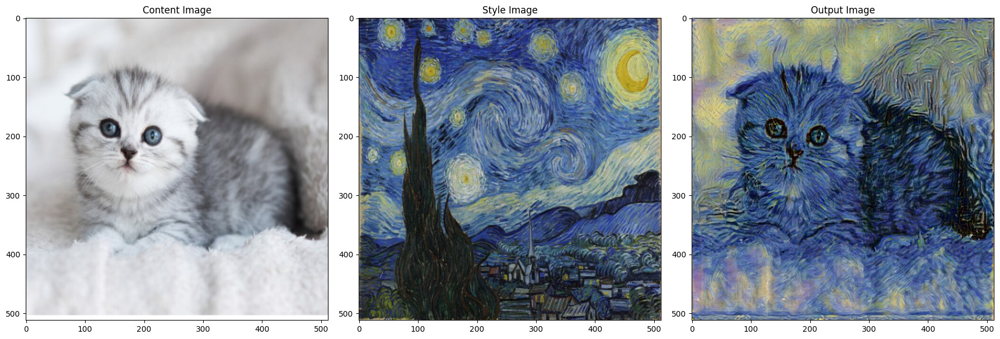

bulding.jpg
Building the style transfer model..
Performing Style Transferring on the image


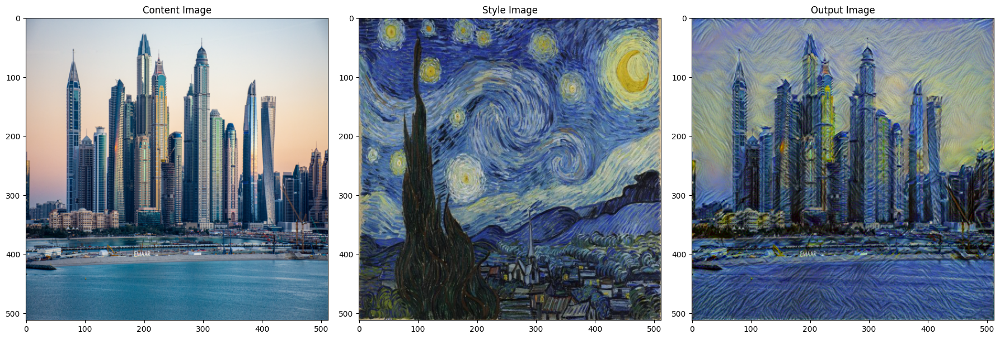

ocean.jpg
Building the style transfer model..
Performing Style Transferring on the image


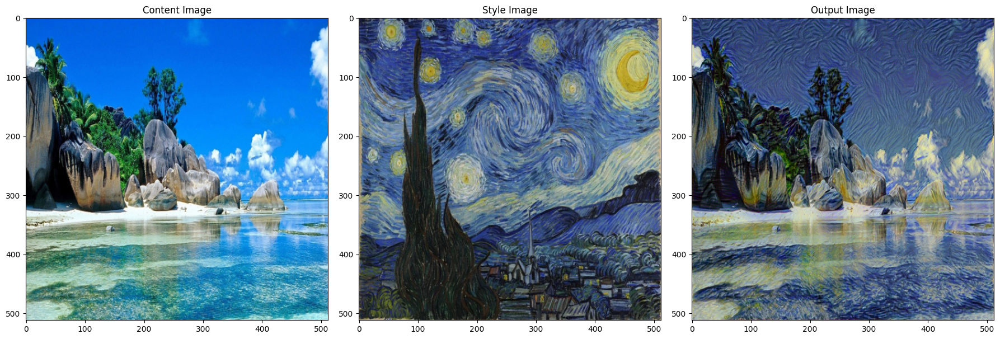

trees.jpg
Building the style transfer model..
Performing Style Transferring on the image


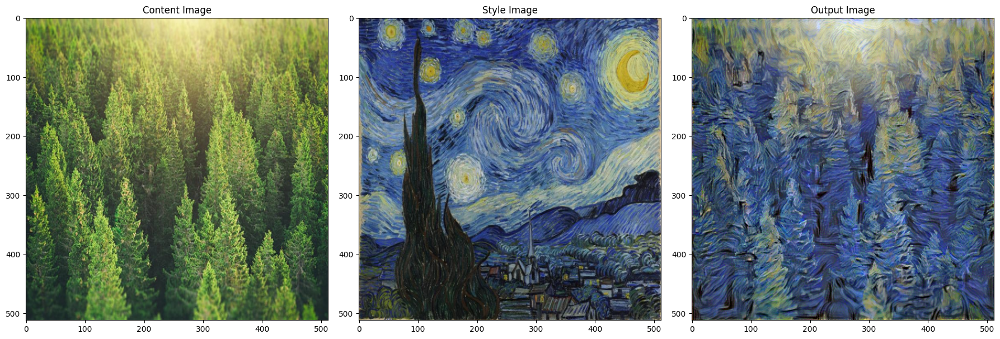

supergirl.jpg
Building the style transfer model..
Performing Style Transferring on the image


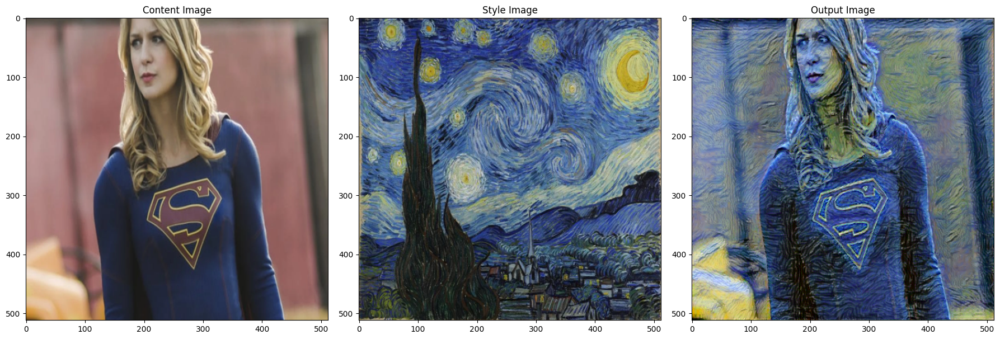

pand.jpg
Building the style transfer model..
Performing Style Transferring on the image


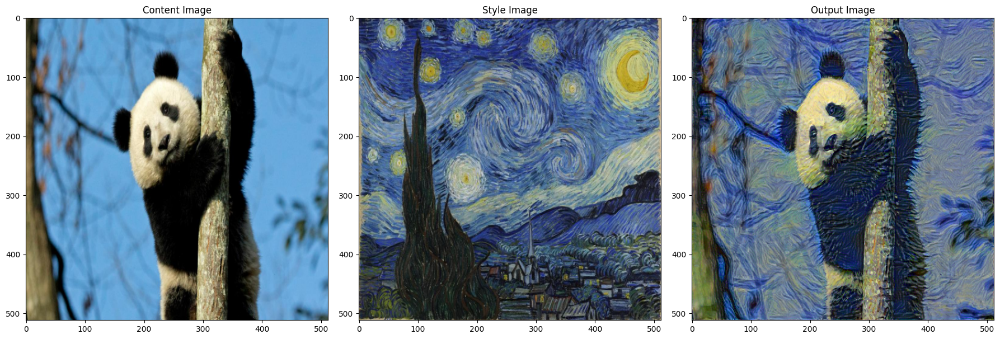

kitten.jpg
Building the style transfer model..
Performing Style Transferring on the image


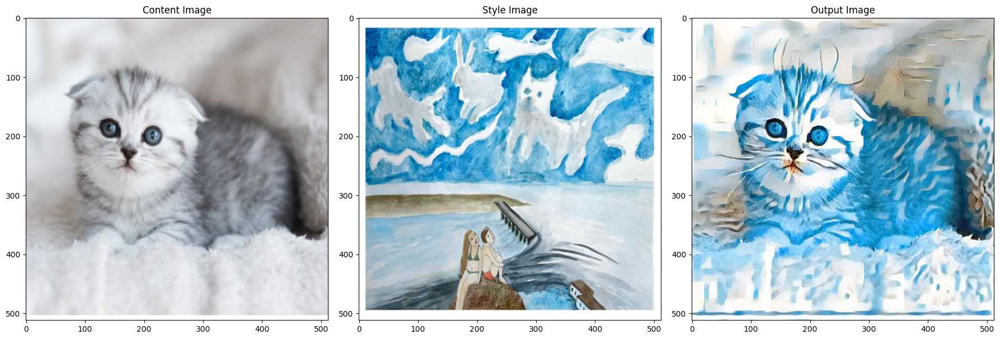

bulding.jpg
Building the style transfer model..
Performing Style Transferring on the image


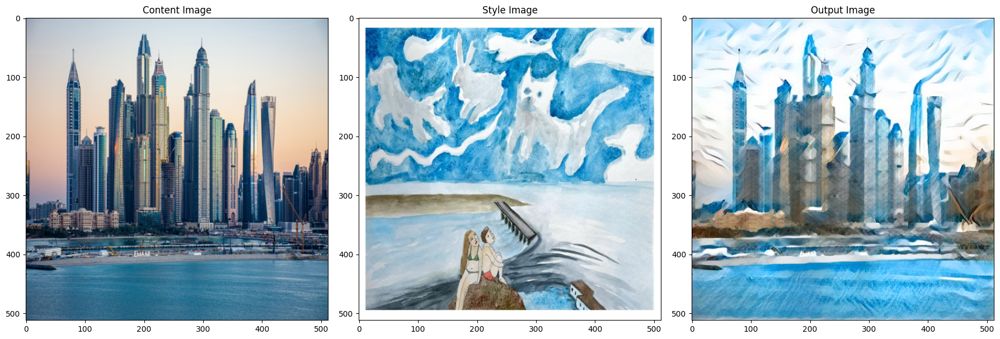

ocean.jpg
Building the style transfer model..
Performing Style Transferring on the image


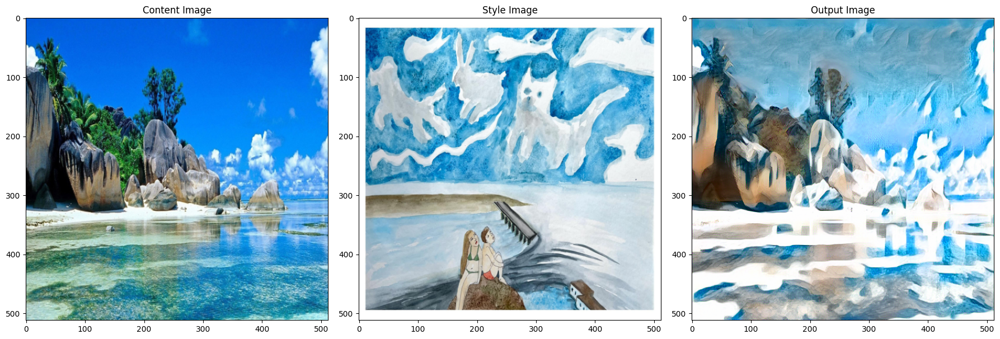

trees.jpg
Building the style transfer model..
Performing Style Transferring on the image


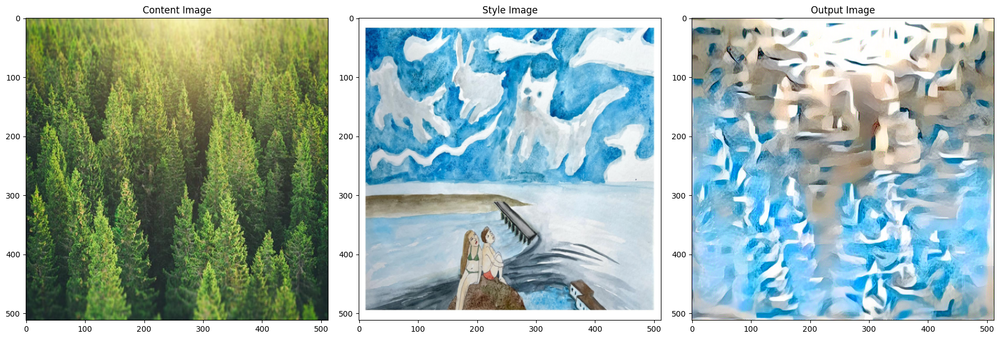

supergirl.jpg
Building the style transfer model..
Performing Style Transferring on the image


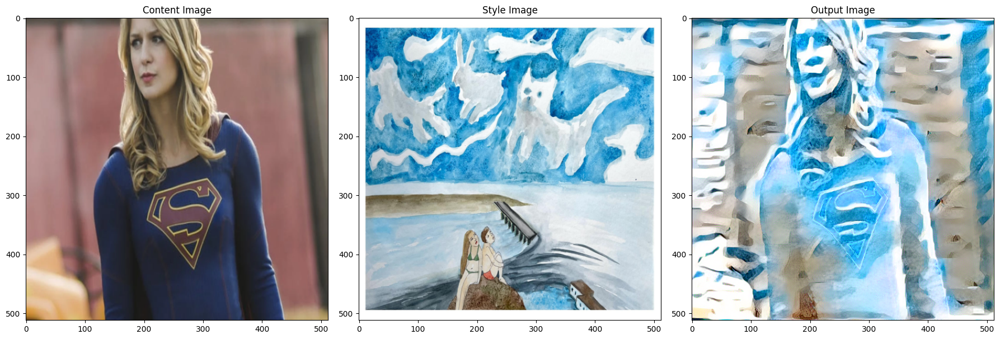

pand.jpg
Building the style transfer model..
Performing Style Transferring on the image


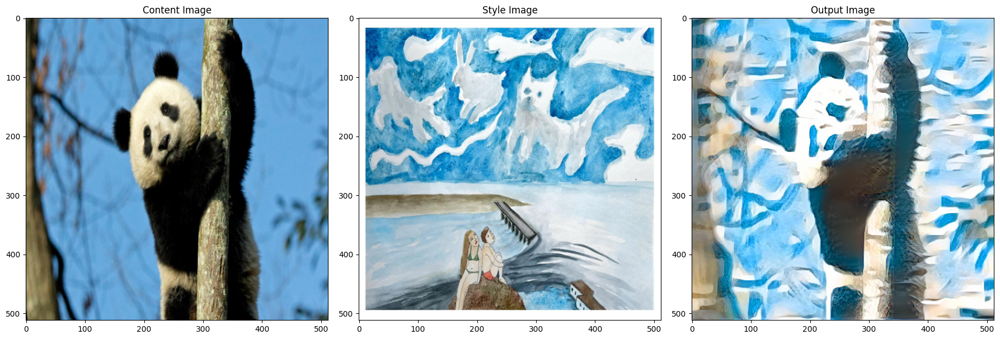

kitten.jpg
Building the style transfer model..
Performing Style Transferring on the image


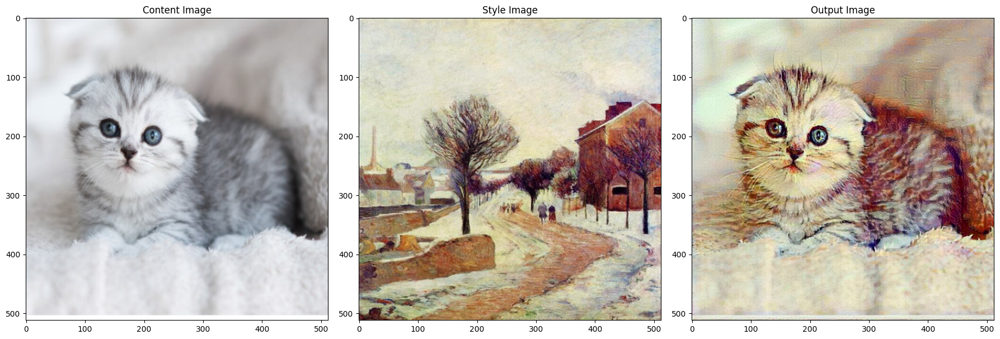

bulding.jpg
Building the style transfer model..
Performing Style Transferring on the image


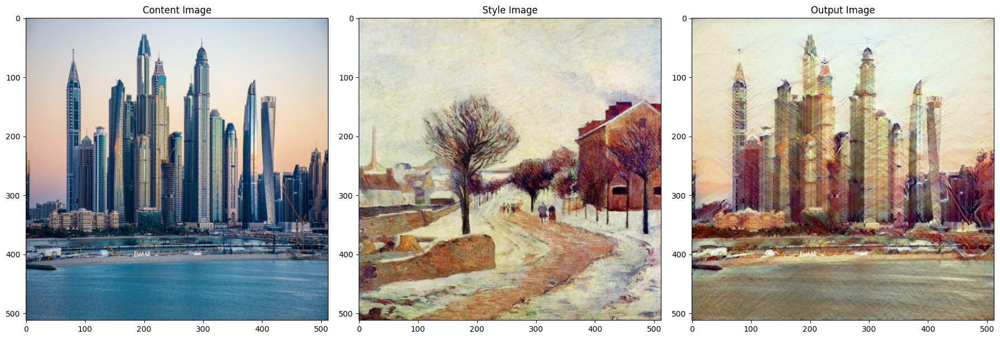

ocean.jpg
Building the style transfer model..
Performing Style Transferring on the image


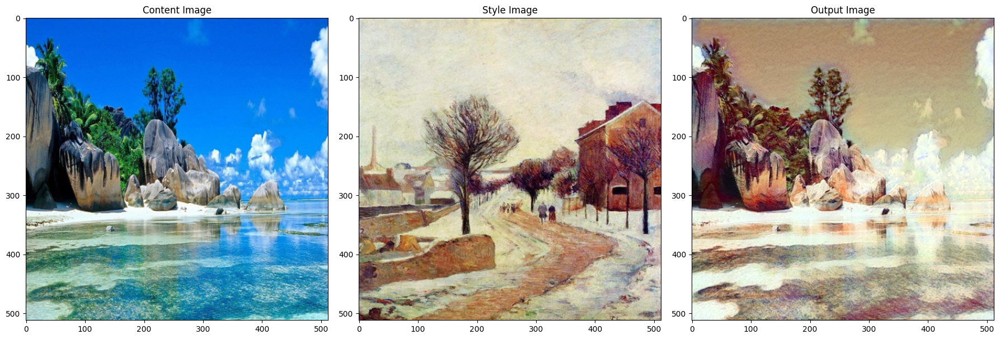

trees.jpg
Building the style transfer model..
Performing Style Transferring on the image


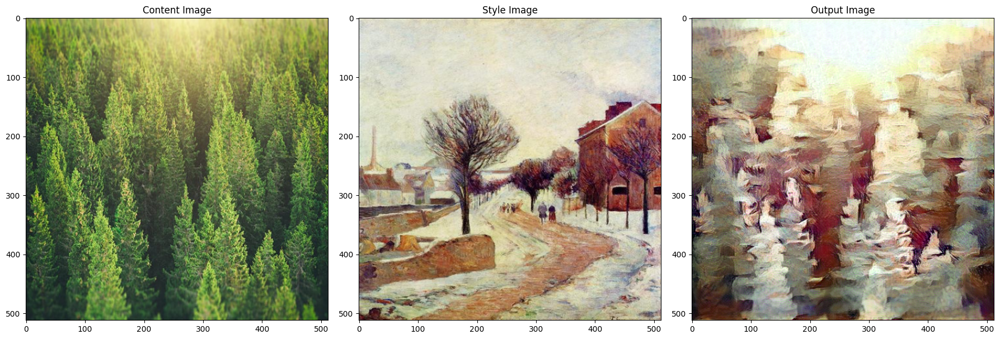

supergirl.jpg
Building the style transfer model..
Performing Style Transferring on the image


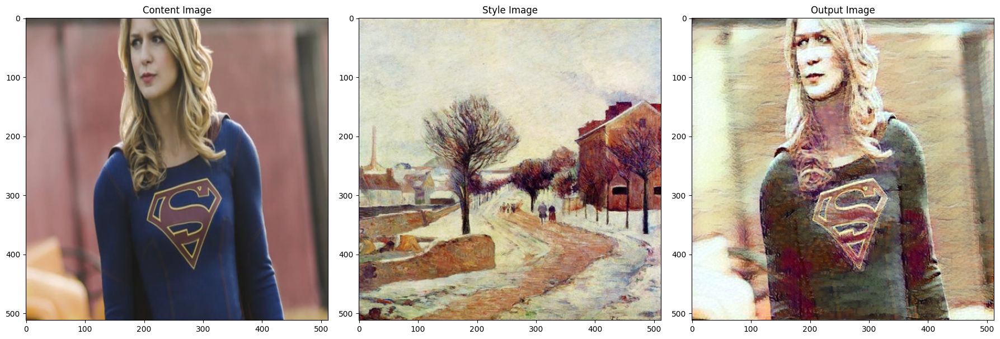

pand.jpg
Building the style transfer model..
Performing Style Transferring on the image


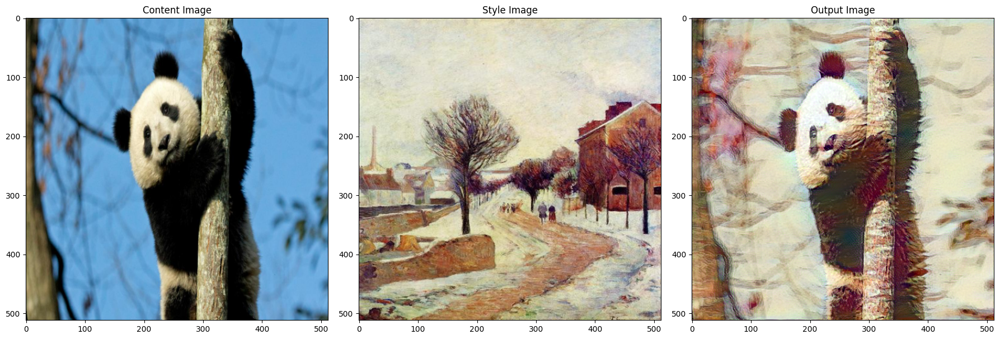

In [24]:
# Assuming art_files and content_files are lists of file names
for art_dir in art_files:
  for content_dir in content_files:
    style_img = preprocess("art/" + art_dir)
    print(content_dir)
    content_img = preprocess("content/" + content_dir)
    assert style_img.size() == content_img.size(), "Import style and content images of the same size"

    # Create input image
    input_img = create_input_image(content_img)

    # Perform style transfer
    output = style_transfer(cnn, cnn_normalization_mean, cnn_normalization_std,
                            content_img, style_img, input_img,max_iterations=300,show_loss_details=False)

    # Display images side by side
    # In each row, we have original content image, style image, and modified content image with style
    fig, axes = plt.subplots(1, 3, figsize=(18, 6))  # Three columns for content, style, and output

    axes[0].imshow(content_img.cpu().squeeze(0).permute(1, 2, 0))
    axes[0].set_title('Content Image')

    axes[1].imshow(style_img.cpu().squeeze(0).permute(1, 2, 0))
    axes[1].set_title('Style Image')

    axes[2].imshow(output.cpu().detach().squeeze(0).permute(1, 2, 0))
    axes[2].set_title('Output Image')

    plt.tight_layout()
    plt.show()